# EDA - Unsupervised learning

## About the dataset

**carat**: Weight of the diamond (continuous) - *Numeric*  
**cut**: Quality of the cut (Fair → Ideal) -	*Categorical*  
**colorDiamond**: Color, from J (worst) to D (best) - *Categorical*  
**clarity**: Clarity grade (I1 worst → IF best) - *Categorical*  
**depth**: Total depth percentage (z / mean(x, y)) - *Numeric*  
**table**: Width of the top of the diamond	- *Numeric*  
**price**: Price in US dollars - *Numeric*  
**x, y, z**: Dimensions in mm (length, width, depth) - *Numeric*  

Will be using the built in diamond dataset from seaborn for this analysis

In [6]:
import seaborn as sns

# See available datasets
print(sns.get_dataset_names())

# Load one
df = sns.load_dataset('diamonds')

df.head()

['anagrams', 'anscombe', 'attention', 'brain_networks', 'car_crashes', 'diamonds', 'dots', 'dowjones', 'exercise', 'flights', 'fmri', 'geyser', 'glue', 'healthexp', 'iris', 'mpg', 'penguins', 'planets', 'seaice', 'taxis', 'tips', 'titanic']


,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [7]:
import plotly.express as px
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Copy original data
df_encoded = df.copy()

# Ordinal encoding
clarity_order = {'I1': 0, 'SI2': 1, 'SI1': 2, 'VS2': 3, 'VS1': 4, 'VVS2': 5, 'VVS1': 6, 'IF': 7}
cut_order = {'Fair': 0, 'Good': 1, 'Very Good': 2, 'Premium': 3, 'Ideal': 4}

df_encoded['clarity'] = df_encoded['clarity'].map(clarity_order)
df_encoded['cut'] = df_encoded['cut'].map(cut_order)

# One-hot encode color
df_encoded = pd.get_dummies(df_encoded, columns=['color'], prefix='color')

# Drop 'price' for unsupervised analysis
df_features = df_encoded.drop(columns=['price'])

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_features)

# PCA to 2D
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X_pca)

# Create DataFrame for plotting
df_plot = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
df_plot['cluster'] = clusters
df_plot['cut'] = df['cut']  # optional: add back original data for hover/info
df_plot['clarity'] = df['clarity']
df_plot['carat'] = df['carat']

# Plot
fig = px.scatter(
    df_plot,
    x='PC1',
    y='PC2',
    color='cluster',
    hover_data=['carat', 'cut', 'clarity'],
    title="KMeans Clusters on PCA-Reduced Diamond Data"
)
fig.show()


c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


X-axis (PC1) and Y-axis (PC2): These are the first two principal components, capturing the most variance in the standardized feature space (carat, cut, clarity, dimensions, etc.).

Each dot = a diamond.

Colors = Cluster labels (0, 1, 2) assigned by KMeans.

In [8]:
from sklearn.metrics import silhouette_score

# Use the scaled data, not PCA-reduced, for accuracy
score = silhouette_score(X_scaled, clusters)
print(f"Silhouette Score: {score:.4f}")

Silhouette Score: 0.1261


+1.0 = perfect, tight and well-separated clusters

~0.5–0.7 = good

~0.25–0.5 = reasonable, but possibly overlapping

< 0.25 = poor — clusters may be arbitrary or too close

If you're below ~0.3, it might be worth:

Trying a different number of clusters (KMeans(n_clusters=4) etc.)

Using UMAP or t-SNE instead of PCA for dimensionality reduction

Removing outliers that distort distances

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluste

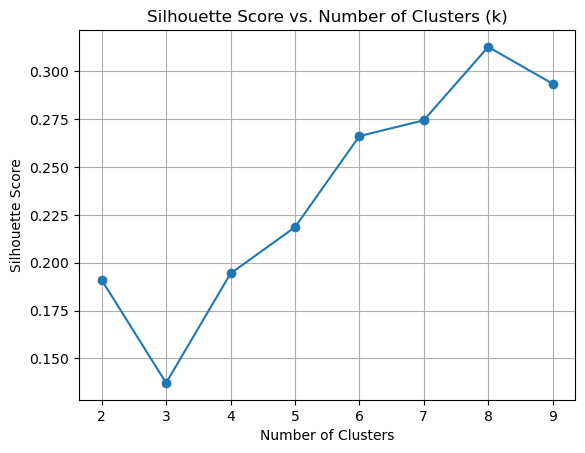

In [9]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

scores = []
range_n = range(2, 10)
for k in range_n:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X_scaled)
    score = silhouette_score(X_scaled, labels)
    scores.append(score)

# Plot the results
import matplotlib.pyplot as plt

plt.plot(range_n, scores, marker='o')
plt.title('Silhouette Score vs. Number of Clusters (k)')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()


### Analysis
Readjust to 8 clusters for better spread

In [11]:
# KMeans clustering
kmeans_revised = KMeans(n_clusters=8, random_state=42)
clusters_revised = kmeans_revised.fit_predict(X_pca)

# Create DataFrame for plotting
df_plot_revised = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
df_plot_revised['cluster'] = clusters_revised
df_plot_revised['cut'] = df['cut']  # optional: add back original data for hover/info
df_plot_revised['clarity'] = df['clarity']
df_plot_revised['carat'] = df['carat']

# Plot
fig = px.scatter(
    df_plot_revised,
    x='PC1',
    y='PC2',
    color='cluster',
    hover_data=['carat', 'cut', 'clarity'],
    title="KMeans Clusters on PCA-Reduced Diamond Data"
)
fig.show()

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [12]:
score = silhouette_score(X_scaled, clusters_revised)
print(f"Silhouette Score: {score:.4f}")

Silhouette Score: 0.0542


In [13]:
import umap

reducer = umap.UMAP(random_state=42)
X_umap = reducer.fit_transform(X_scaled)

kmeans = KMeans(n_clusters=8, random_state=42)
clusters_umap = kmeans.fit_predict(X_umap)

score_umap = silhouette_score(X_scaled, clusters_umap)
print(f"UMAP + KMeans silhouette score: {score_umap:.4f}")


c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

c:\Users\danie\anaconda3\envs\ai_l1\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



UMAP + KMeans silhouette score: 0.2638


Clear imporvement - proceeding to visualize

In [ ]:
import plotly.express as px
import pandas as pd

df_umap = pd.DataFrame(X_umap, columns=["UMAP1", "UMAP2"])
df_umap["cluster"] = clusters_umap
df_umap["carat"] = df["carat"]
df_umap["cut"] = df["cut"]
df_umap["clarity"] = df["clarity"]

fig = px.scatter(
    df_umap,
    x="UMAP1",
    y="UMAP2",
    color="cluster",
    hover_data=["carat", "cut", "clarity"],
    title="UMAP + KMeans Clusters on Diamond Data"
)
fig.show()

